# SVM и его ядра

В этом задании нам предстоит решить задачу SVM при помощи `cvxopt` и применить ее к искуственным данным. Затем аналогичным способом нужно будет решить задачу ядерного SVM и исследовать его поведение для различных ядер и значений их параметров.

In [1]:
import numpy as np
import copy
from cvxopt import spmatrix, matrix, solvers, sparse
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification, make_moons, make_blobs
from sklearn.metrics import pairwise_distances
from typing import NoReturn, Callable

%matplotlib inline
solvers.options['show_progress'] = False

In [2]:
def visualize(clf, X, y):
    x_min, x_max = X[:, 0].min(), X[:, 0].max()
    y_min, y_max = X[:, 1].min(), X[:, 1].max()
    x_border = (x_max - x_min) / 20 + 1.0e-3
    x_h = (x_max - x_min + 2 * x_border) / 200
    y_border = (y_max - y_min) / 20 + 1.0e-3
    y_h = (y_max - y_min + 2 * y_border) / 200
    
    cm = plt.cm.Spectral

    xx, yy = np.meshgrid(np.arange(x_min - x_border, x_max + x_border, x_h), np.arange(y_min - y_border, y_max + y_border, y_h))
    mesh = np.c_[xx.ravel(), yy.ravel()]

    z_class = clf.predict(mesh).reshape(xx.shape)

    # Put the result into a color plot
    plt.figure(1, figsize=(8, 8))
    plt.pcolormesh(xx, yy, z_class, cmap=cm, alpha=0.3, shading='gouraud')

    # Plot hyperplane and margin
    z_dist = clf.decision_function(mesh).reshape(xx.shape)
    plt.contour(xx, yy, z_dist, [0.0], colors='black')
    plt.contour(xx, yy, z_dist, [-1.0, 1.0], colors='black', linestyles='dashed')

    # Plot also the training points
    y_pred = clf.predict(X)

    ind_support = []
    ind_correct = []
    ind_incorrect = []
    cnt = 0
    for i in range(len(y)):
        if i in clf.support:
            ind_support.append(i)
        elif y[i] == y_pred[i]:
            ind_correct.append(i)
        else:
            ind_incorrect.append(i)
        
        if y[i] == y_pred[i]:
            cnt += 1

    plt.scatter(X[ind_correct, 0], X[ind_correct, 1], c=y[ind_correct], cmap=cm, alpha=1., edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_incorrect, 0], X[ind_incorrect, 1], c=y[ind_incorrect], cmap=cm, alpha=1., marker='*',
               s=50, edgecolor='black', linewidth=.8)
    plt.scatter(X[ind_support, 0], X[ind_support, 1], c=y[ind_support], cmap=cm, alpha=1., edgecolor='yellow', linewidths=1.,
               s=40)
    
    print(f"Support vectors number = {len(ind_support)} / {X.shape[0]}")
    print(f"Accuracy = {cnt / len(y)}")

    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.tight_layout()

In [3]:
def generate_dataset(moons=False):
    if moons:
        X, y = make_moons(1000, noise=0.075, random_state=42)
        return X, 2 * y - 1
    X, y = make_blobs(1000, 2, centers=[[0, 0], [-4, 2], [3.5, -2.0], [3.5, 3.5]], random_state=42)
    y = 2 * (y % 2) - 1
    return X, y

X, y = generate_dataset(True)

### Задание 1 (2 балла)
Для начала реализуем обычный линейный SVM. 

#### Методы
`fit(X, y)` - обучает SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Поля
`support` - индексы опорных элементов

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

А наша задача формулируется так:

$\begin{cases}0.5 \cdot w^\text{T}w + C \cdot \sum \xi_i \rightarrow \min_{w, \xi} \\ \xi \geq 0 \\ y_i (w^\text{T}x_i + w_0) \geq 1 - \xi_i \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = (w, w_0, \xi) \\ P = 
\left[
    \begin{array}{c|c}
      I & 0\\
      \hline
      0 & 0
    \end{array}
\right] \\ 
q = \left[
    \begin{array}{c}
      0 \\
      \hline
      C 
    \end{array}
\right] \\ 
 G = 
\left[
    \begin{array}{c|c|c}
      0 & 0 & -I\\
      \hline
      -yX & -y & -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      0 \\
      \hline
      -1 
    \end{array}
\right] $

In [4]:
class LinearSVM:
    def __init__(self, C: float):
        """
        
        Parameters
        ----------
        C : float
            Soft margin coefficient.
        
        """
        self.C = C
        self.support = None

    def fit(self, X: np.ndarray, y: np.ndarray) -> NoReturn:
        """
        Обучает SVM, решая задачу оптимизации при помощи cvxopt.solvers.qp
        
        Parameters
        ----------
        X : np.ndarray
            Данные для обучения SVM.
        y : np.ndarray
            Бинарные метки классов для элементов X 
            (можно считать, что равны -1 или 1). 
        
        """
                
        m, n = X.shape
        y = y.reshape(-1,1) * 1. 

        P = matrix([[matrix(np.eye(n)), matrix(np.zeros((m + 1, n)))], [matrix(np.zeros((n, m + 1))), matrix(np.zeros((m + 1, m + 1)))]])
        q = matrix(np.hstack((np.zeros(n + 1), np.ones(m) * self.C))) 
        G = matrix([[matrix(np.zeros((m, n))), matrix(-y * X)], [matrix(np.zeros((m, 1))), matrix(-y)], [matrix(-np.eye(m, m)), matrix(-np.eye(m, m))]]) 
        h = matrix(np.hstack((np.zeros(m), -np.ones(m)))) 
        
        sol = np.array(solvers.qp(P, q, G, h)['x'])
        self.W = sol[:n]
        self.b = sol[n]
        
        self.support = np.where(sol[n + 1:] > 1e-5)[0]

    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """
        Возвращает значение решающей функции.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, для которых нужно посчитать значение решающей функции.

        Return
        ------
        np.ndarray
            Значение решающей функции для каждого элемента X 
            (т.е. то число, от которого берем знак с целью узнать класс).     
        
        """
        
        return X @ self.W - self.b

    def predict(self, X: np.ndarray) -> np.ndarray:
        """
        Классифицирует элементы X.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, которые нужно классифицировать

        Return
        ------
        np.ndarray
            Метка класса для каждого элемента X.   
        
        """
        
        return np.sign(self.decision_function(X))

Support vectors number = 276 / 1000
Accuracy = 0.863


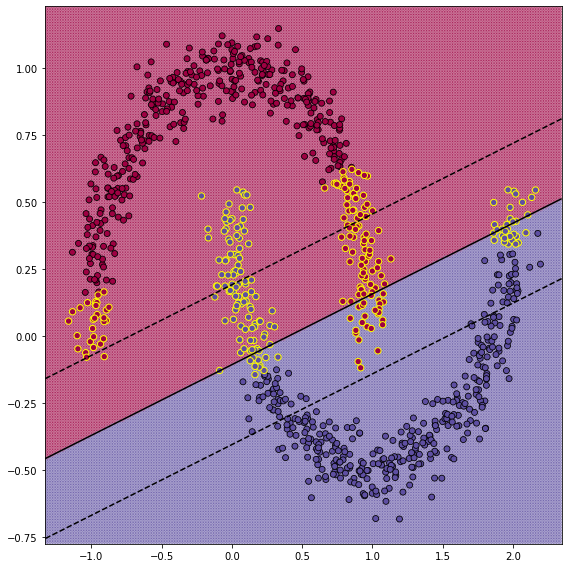

In [5]:
X, y = generate_dataset(True)
svm = LinearSVM(1)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

Support vectors number = 128 / 1000
Accuracy = 0.753


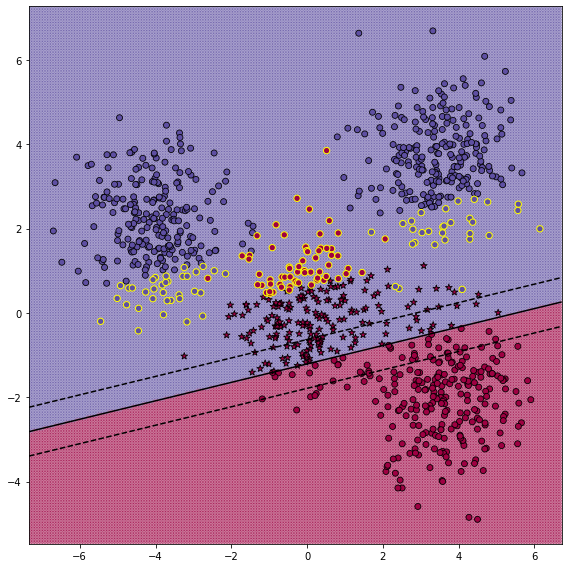

In [6]:
X, y = generate_dataset(False)
svm = LinearSVM(1)
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

### Задание 2 (2 балла)
Перед реализацией ядерного SVM, реализуем функции, которые строят ядра.

#### Описание
`get_polynomial_kernel(power)` - возвращает полиномиальное ядро с заданной константой и степенью

`get_gaussian_kernel(sigma=1.)` - возвращает ядро Гаусса с заданным коэффицинтом сигма

In [7]:
def get_polynomial_kernel(c=1, power=2):
    "Возвращает полиномиальное ядро с заданной константой и степенью"
    
    return (lambda x1, x2: ((x1 @ x2.T) + c) ** power)

def get_gaussian_kernel(sigma=1.):
    "Возвращает ядро Гаусса с заданным коэффицинтом сигма"
    
    return (lambda x1, x2: np.exp(-np.power(pairwise_distances(x1, x2), 2) / (2 * np.power(sigma, 2))))

### Задание 3 (2 балла)
Теперь перейдем к реализации самого kernel SVM.

#### Описание
`fit(X, y)` - обучает kernel SVM, решая задачу оптимизации при помощи `cvxopt.solvers.qp`

`decision_function(X)` - возвращает значение решающей функции (т.е. то число, от которого берем знак с целью узнать класс)

#### Конструктор
`kernel` - ядро-функция

### Решение с помощью QP Solver

QP-solver решает такую задачу:

$\begin{cases}0.5 \cdot x^\text{T}Px + q^\text{T}x\rightarrow \min_x\\Gx \leq h\\Ax=b\end{cases}$

Будем решать двойственную задачу. Формулируется она так:

$\begin{cases}\sum \alpha_i - 0.5 \sum \alpha_i \alpha_j y_i y_j K(x_i, x_j) \rightarrow \max_{\alpha}\\ C \geq \alpha \geq 0 \\ y_i \alpha = 0 \end{cases}$

Сведем ее к задаче QP-solver'а:

$ x = \alpha \\ P = 
\left[ y_i y_j K(y_i, y_j) \right] \\ 
q = \left[ -1
\right] \\ 
 G = 
\left[
    \begin{array}{c}
      I\\
      \hline
      -I
    \end{array}
\right] \\ h = \left[
    \begin{array}{c}
      C \\
      \hline
      0 
    \end{array}
\right] \\
b = 0\\
A = y^\text{T}$

В таком случае решающей функцией будет:

$a(x) = \text{sign} (\sum \alpha_i y_i K(x, x_i) + w_0)$, где $w_0 = \frac{1}{n}\sum\limits_{i=1}^{n}[y_i - \sum \alpha_j y_j K(x_i, x_j)]$

In [8]:
class KernelSVM:
    def __init__(self, C: float, kernel: Callable): #= linear_kernel):
        """
        
        Parameters
        ----------
        C : float
            Soft margin coefficient.
        kernel : Callable
            Функция ядра.
        
        """
        self.C = C
        self.kernel = kernel
        self.support = None

    def fit(self, X: np.ndarray, y: np.ndarray) -> NoReturn:
        """
        Обучает SVM, решая задачу оптимизации при помощи cvxopt.solvers.qp
        
        Parameters
        ----------
        X : np.ndarray
            Данные для обучения SVM.
        y : np.ndarray
            Бинарные метки классов для элементов X 
            (можно считать, что равны -1 или 1). 
        
        """
        
        m, n = X.shape
        y = y.reshape(-1, 1) * 1.

        P = matrix((y @ y.T) * self.kernel(X, X))
        q = matrix(-np.ones(m))
        G = matrix(np.vstack((np.eye(m), -np.eye(m))))
        h = matrix(np.vstack(((np.ones((m, 1)) * self.C), np.zeros((m, 1)))))
        A = matrix(y.T)
        b = matrix(np.zeros(1))
        
        self.alphas = np.array(solvers.qp(P, q, G, h, A, b)['x'])
                
        self.support = np.where(self.alphas > 1e-5)[0]
        
        self.support_X = X[self.support]
        self.support_y = y[self.support]
        self.support_alphas = self.alphas[self.support]
        
        self.w0 = np.mean(self.support_y - np.sum(self.support_alphas.T * self.support_y.T * self.kernel(self.support_X, self.support_X), axis=1))

    def decision_function(self, X: np.ndarray) -> np.ndarray:
        """
        Возвращает значение решающей функции.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, для которых нужно посчитать значение решающей функции.

        Return
        ------
        np.ndarray
            Значение решающей функции для каждого элемента X 
            (т.е. то число, от которого берем знак с целью узнать класс).     
        
        """
                
        return np.sum(self.support_alphas.T * self.support_y.T * self.kernel(X, self.support_X), axis=1) + self.w0
                
    def predict(self, X: np.ndarray) -> np.ndarray:
        """
        Классифицирует элементы X.
        
        Parameters
        ----------
        X : np.ndarray
            Данные, которые нужно классифицировать

        Return
        ------
        np.ndarray
            Метка класса для каждого элемента X.   
        
        """
        
        return np.sign(self.decision_function(X))

Support vectors number = 35 / 1000
Accuracy = 1.0


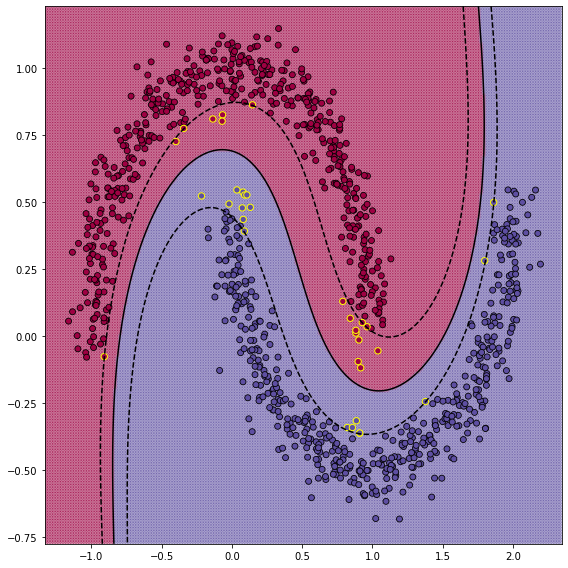

In [9]:
X, y = generate_dataset(True)
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

Support vectors number = 31 / 1000
Accuracy = 0.991


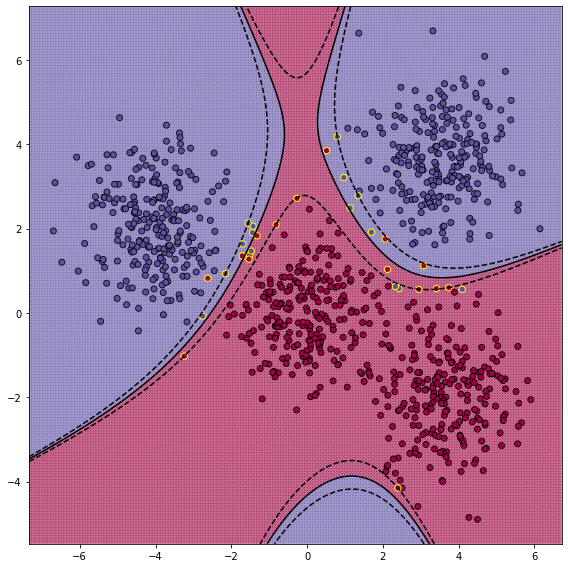

In [10]:
X, y = generate_dataset(False)
svm = KernelSVM(1, kernel=get_polynomial_kernel(1, 3))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

Support vectors number = 33 / 1000
Accuracy = 1.0


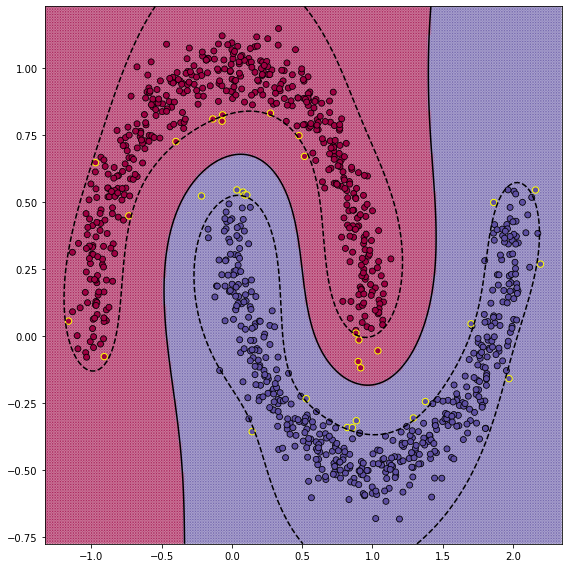

In [11]:
X, y = generate_dataset(True)
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

Support vectors number = 657 / 1000
Accuracy = 0.994


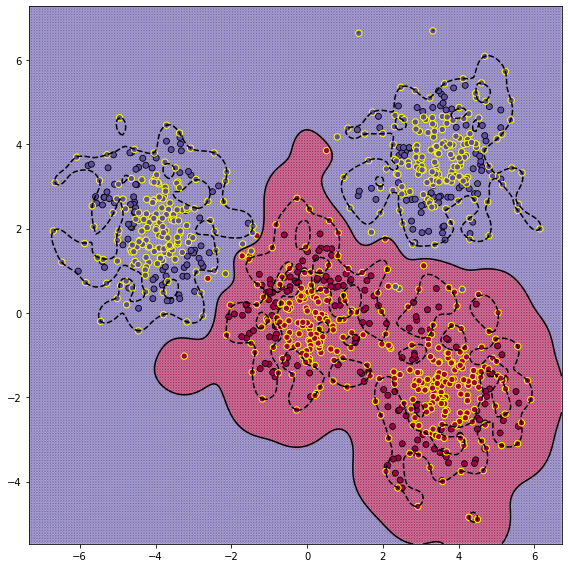

In [12]:
X, y = generate_dataset(False)
svm = KernelSVM(1, kernel=get_gaussian_kernel(0.4))
svm.fit(X, y)
visualize(svm, X, y)
plt.show()

### Задание 4 (3 балла)
Исследуйте и опишите влияние параметров каждого вида ядра на полученный классификатор. Что происходит при увеличении константы в полиномиальном ядре? При увеличении степени? Как влияет на результат сигма в ядре Гаусса?

__При выполнении этого задания стоит написать код, который визуализирует классификаторы с различными ядрами__

Гауссианово ядро: просто вспоминая картикну можно понять, что чем меньше $\sigma$, тем больше variance и меньше bias.

И наоборот, чем больше $\sigma$, тем меньше variance и больше bias. 

Иными словами, если нам кажется, что модель недообучилась, то стоить увеличить $\sigma$. Если кажется, что переобучилась - то стоит уменьшить $\sigma$

С точки зрения графика: граница при росте $\sigma$ становится более общей и плавной формы, т.е. упрощается.

# Gauss Kernel, $\sigma$, moons

In [13]:
def gauss_sigma_moons(sigma):
    X, y = generate_dataset(True)
    svm = KernelSVM(1, kernel=get_gaussian_kernel(sigma))
    svm.fit(X, y)
    visualize(svm, X, y)
    print(f'Sigma = {sigma}')
    plt.show()

Support vectors number = 180 / 1000
Accuracy = 1.0
Sigma = 0.1


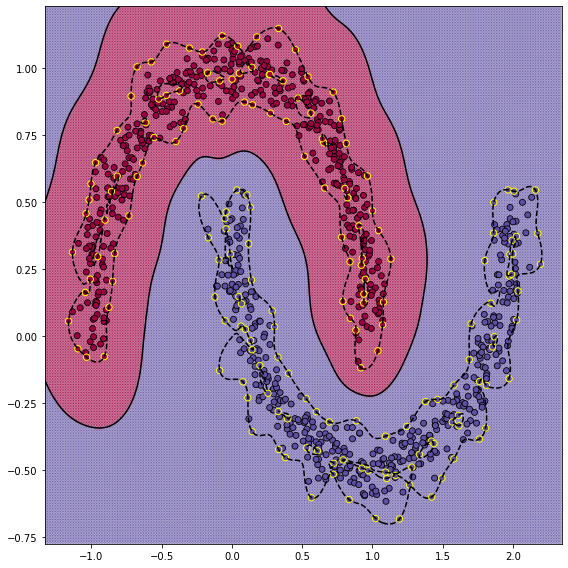

Support vectors number = 42 / 1000
Accuracy = 1.0
Sigma = 0.3


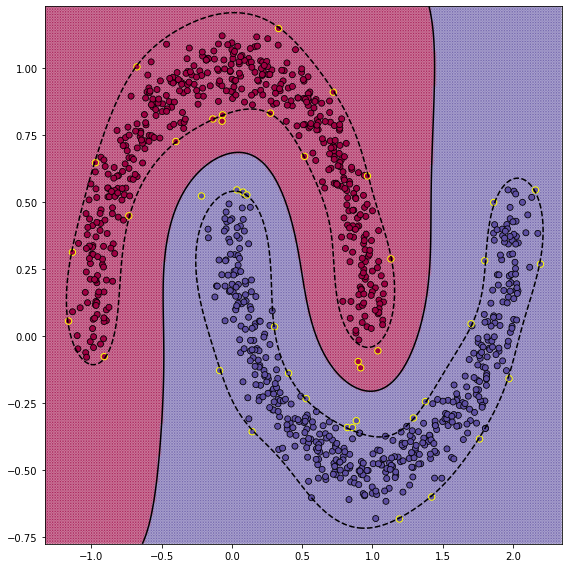

Support vectors number = 110 / 1000
Accuracy = 0.999
Sigma = 1


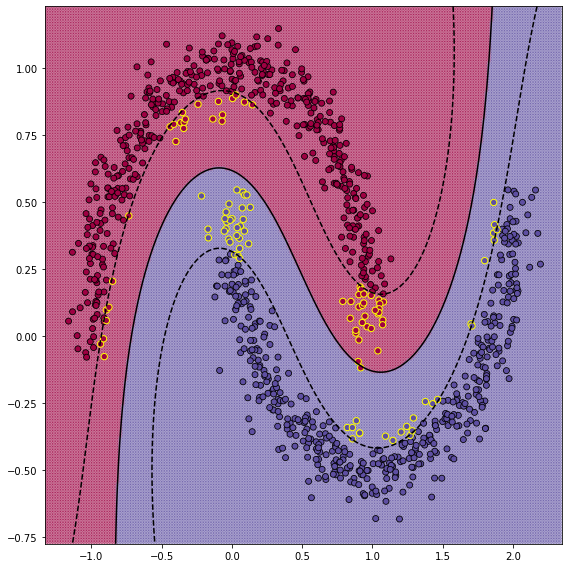

Support vectors number = 340 / 1000
Accuracy = 0.879
Sigma = 3


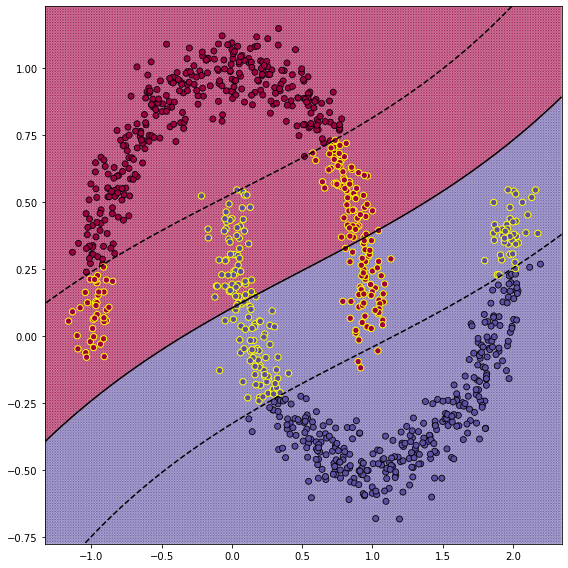

In [14]:
gauss_sigma_moons(0.1)
gauss_sigma_moons(0.3)
gauss_sigma_moons(1)
gauss_sigma_moons(3)

Также трейдофф между bias и variance виден по кол-ву векторов, выбранных опорными. Чем меньше - тем лучше. 

Видно, что при маленьких и больших $\sigma$ оно велико, а по серединке мало.

# Gauss kernel, $\sigma$, blobs

In [15]:
def gauss_sigma_blobs(sigma):
    X, y = generate_dataset(False)
    svm = KernelSVM(1, kernel=get_gaussian_kernel(sigma))
    svm.fit(X, y)
    visualize(svm, X, y)
    print(f'Sigma = {sigma}')
    plt.show()

Support vectors number = 881 / 1000
Accuracy = 1.0
Sigma = 0.1


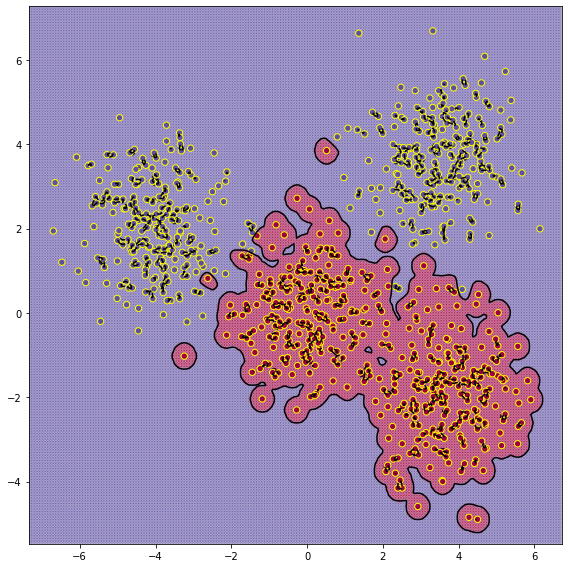

Support vectors number = 695 / 1000
Accuracy = 0.996
Sigma = 0.3


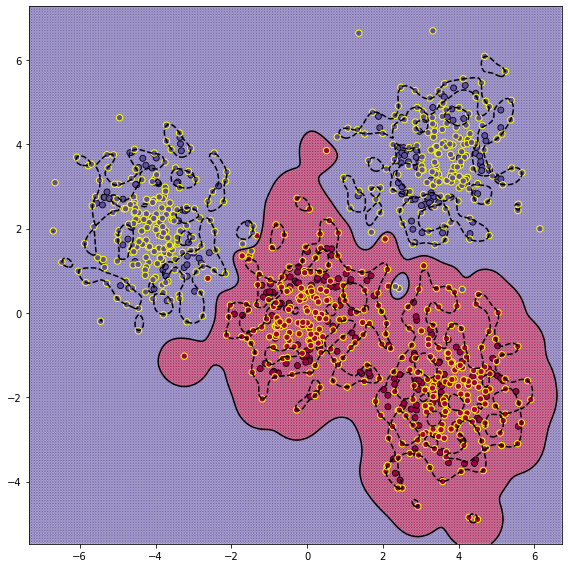

Support vectors number = 97 / 1000
Accuracy = 0.991
Sigma = 1


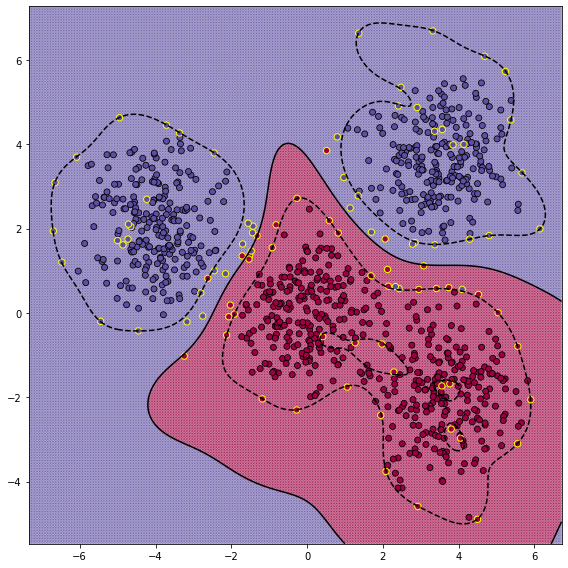

Support vectors number = 72 / 1000
Accuracy = 0.991
Sigma = 3


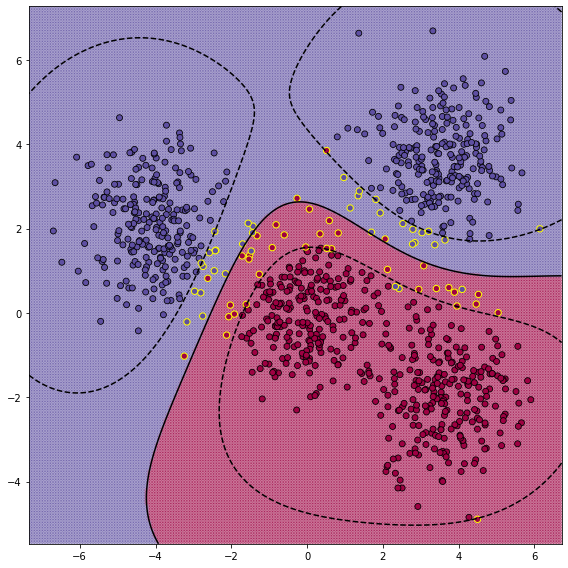

In [16]:
gauss_sigma_blobs(0.1)
gauss_sigma_blobs(0.3)
gauss_sigma_blobs(1)
gauss_sigma_blobs(3)

# Polynomial Kernel, constant, moons

Степень будет 3, потому что $x^3$ хорошо разделяет луны.

Вообще это не сильно заметно, но что происходит:
    
При помощи полиномиального ядра мы переходим в гильбертово пространство большей размерности. 
И при увеличении константа в ядре, почти все координаты вектора в новом пространстве увеличатся (по-разному), либо не изменятся. Точно не уменьшатся. 

Поэтому расстояние между точками в новом пространстве должно расти с ростом константы. Соответственно та единичка, которой мы меряем расстояние от decision boundary до опорных границ классов, визуально станет меньше и ширина "полосы" станет меньше.

In [17]:
def poly_const_moons(c):
    X, y = generate_dataset(True)
    svm = KernelSVM(1, kernel=get_polynomial_kernel(c, 3))
    svm.fit(X, y)
    visualize(svm, X, y)
    print(f'Constant = {c}')
    plt.show()

Support vectors number = 102 / 1000
Accuracy = 1.0
Constant = 0.1


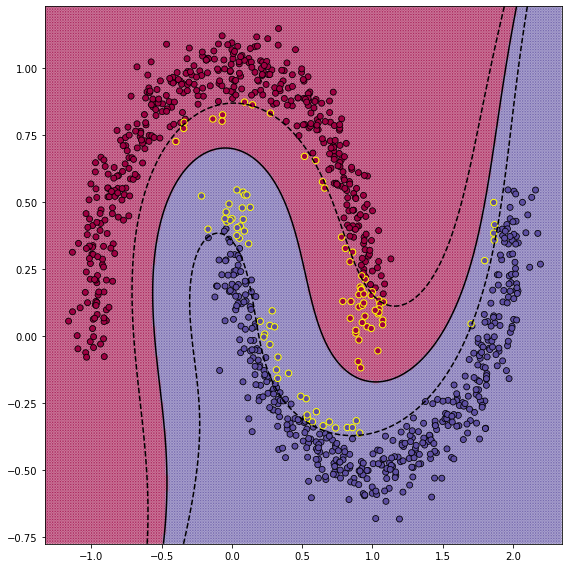

Support vectors number = 24 / 1000
Accuracy = 1.0
Constant = 10000


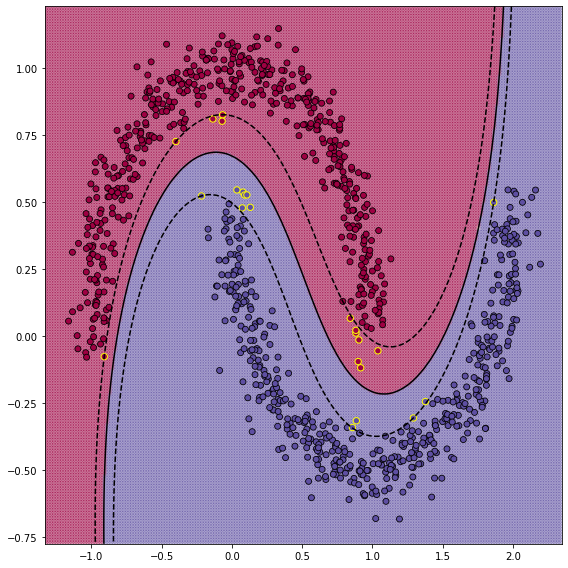

In [18]:
poly_const_moons(0.1)
poly_const_moons(10000)

# Polynomial Kernel, constant, blobs

In [19]:
def poly_const_blobs(c):
    X, y = generate_dataset(False)
    svm = KernelSVM(1, kernel=get_polynomial_kernel(c, 3))
    svm.fit(X, y)
    visualize(svm, X, y)
    print(f'Constant = {c}')
    plt.show()

Support vectors number = 32 / 1000
Accuracy = 0.988
Constant = 0


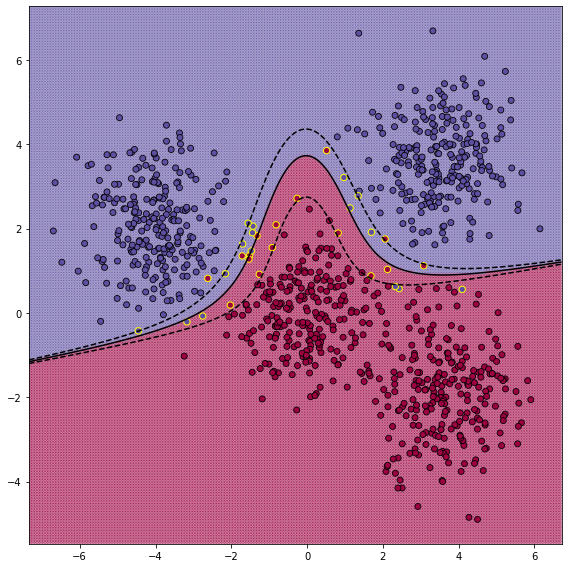

Support vectors number = 31 / 1000
Accuracy = 0.991
Constant = 10000


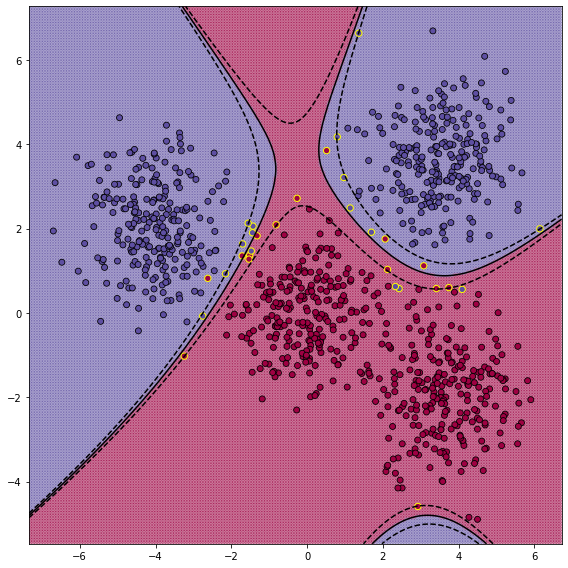

In [20]:
poly_const_blobs(0)
poly_const_blobs(10000)

# Polynomial kernel, degree, moons

Граница становится более плавной при увеличении степени, что очевидно.

In [21]:
def poly_degree_moons(degree):
    X, y = generate_dataset(True)
    svm = KernelSVM(1, kernel=get_polynomial_kernel(1, degree))
    svm.fit(X, y)
    visualize(svm, X, y)
    print(f'Degree = {degree}')
    plt.show()

Support vectors number = 279 / 1000
Accuracy = 0.882
Degree = 1


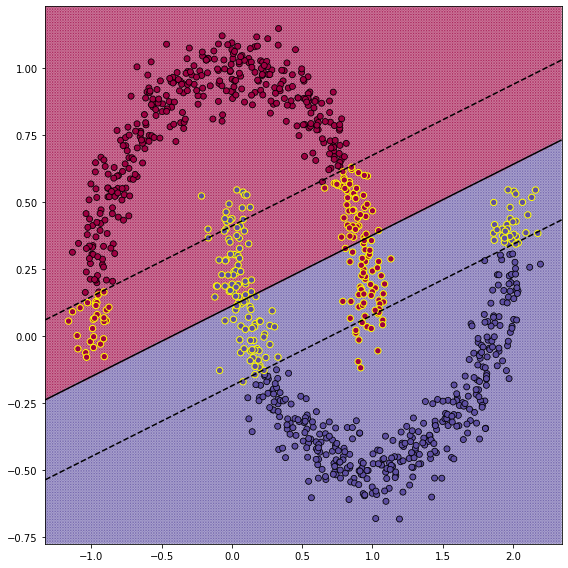

Support vectors number = 271 / 1000
Accuracy = 0.878
Degree = 2


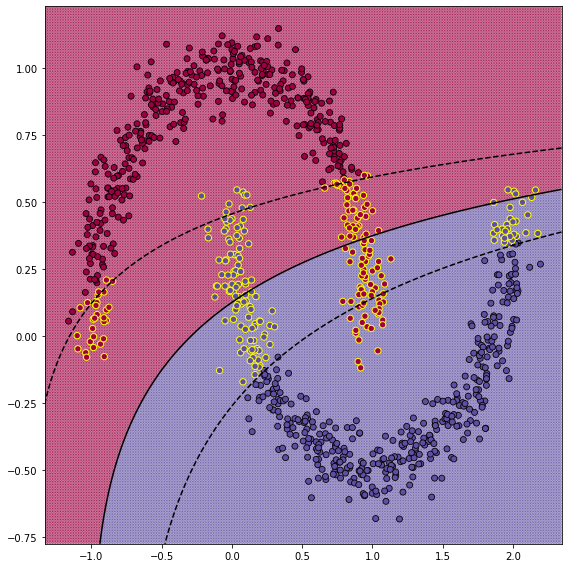

Support vectors number = 35 / 1000
Accuracy = 1.0
Degree = 3


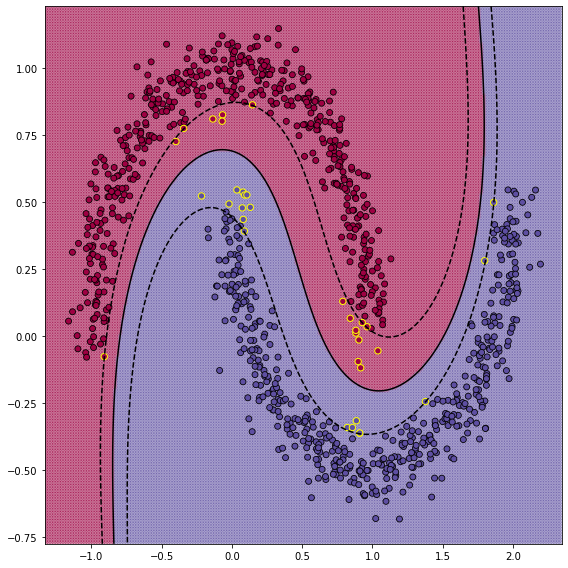

Support vectors number = 12 / 1000
Accuracy = 1.0
Degree = 5


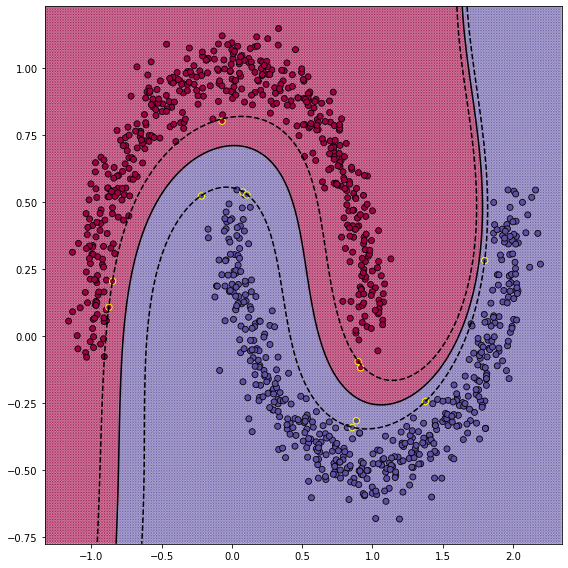

In [22]:
poly_degree_moons(1)
poly_degree_moons(2)
poly_degree_moons(3)
poly_degree_moons(5)

# Polynomial kernel, degree, blobs

In [23]:
def poly_degree_blobs(degree):
    X, y = generate_dataset(False)
    svm = KernelSVM(1, kernel=get_polynomial_kernel(1, degree))
    svm.fit(X, y)
    visualize(svm, X, y)
    print(f'Degree = {degree}')
    plt.show()

Support vectors number = 131 / 1000
Accuracy = 0.949
Degree = 1


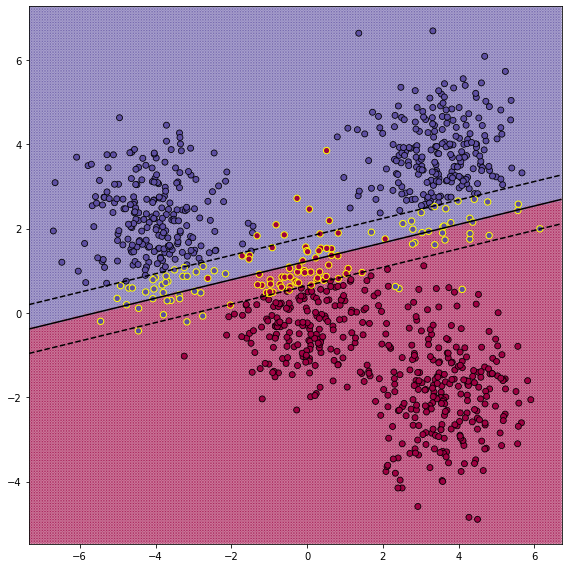

Support vectors number = 41 / 1000
Accuracy = 0.99
Degree = 2


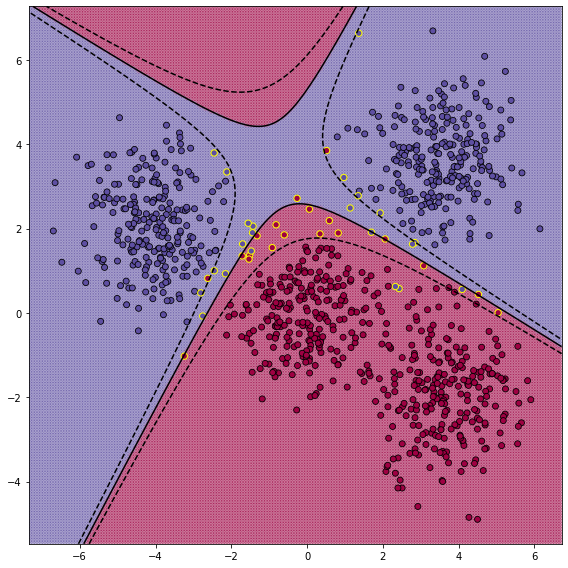

Support vectors number = 31 / 1000
Accuracy = 0.991
Degree = 3


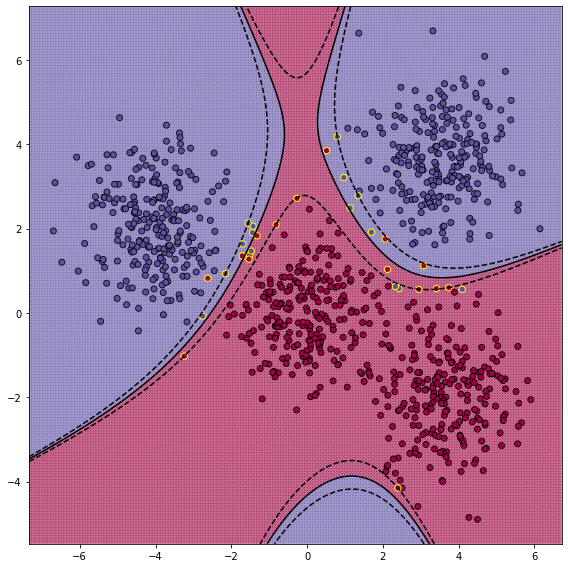

Support vectors number = 27 / 1000
Accuracy = 0.992
Degree = 5


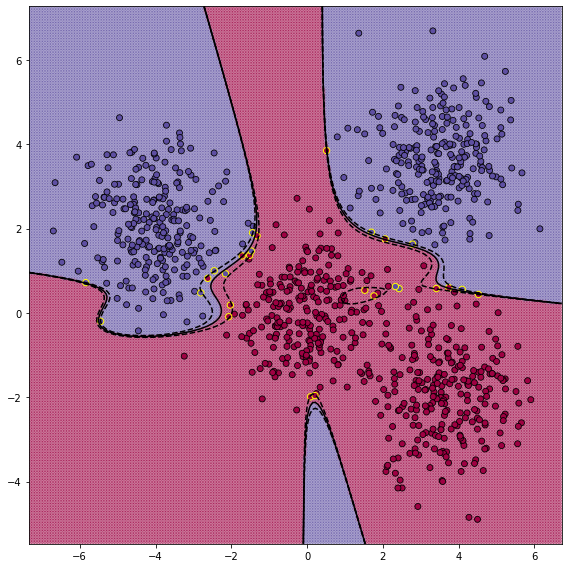

In [24]:
poly_degree_blobs(1)
poly_degree_blobs(2)
poly_degree_blobs(3)
poly_degree_blobs(5)